## Packages

In [1]:
import time
import pandas as pd
import numpy as np
import random

import matplotlib.pyplot as plt
%matplotlib widget

import warnings
from sklearn.metrics import mean_absolute_error,mean_squared_error,mean_absolute_percentage_error

from models.ab import AnalogBivariate

In [30]:
import statsmodels.api as sm
import statsmodels.tools.eval_measures as bias

from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.ar_model import AutoReg

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.cluster import MiniBatchKMeans, KMeans
from sklearn.neighbors import NearestNeighbors, KNeighborsClassifier
from sklearn.linear_model import LinearRegression, RidgeCV, LassoCV, ElasticNetCV, LarsCV, Lasso, Ridge, BayesianRidge, LinearRegression
from sklearn.metrics import mean_absolute_error,mean_squared_error,mean_absolute_percentage_error
from sklearn.metrics.pairwise import pairwise_distances_argmin
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, VotingRegressor, AdaBoostRegressor, BaggingRegressor
from sklearn.cross_decomposition import PLSRegression
from sklearn.decomposition import PCA
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn import preprocessing

from dtw import *
from scipy import stats

from sktime.forecasting.arima import AutoARIMA

from statsmodels.tsa.api import ExponentialSmoothing, SimpleExpSmoothing, Holt

## Load data

In [2]:
df = pd.read_excel('data.xlsx')

In [5]:
df

,Year,Month,Day,Weekday,Hour,T1,T2,T3,T4,Load
0,2002,1,1,3,1,43,43.0,60.0,31.0,1384494.0
1,2002,1,1,3,2,42,42.0,58.0,29.0,1392822.0
2,2002,1,1,3,3,41,41.0,57.0,31.0,1407887.0
3,2002,1,1,3,4,41,41.0,56.0,30.0,1438658.0
4,2002,1,1,3,5,40,41.0,53.0,29.0,1484046.0
...,...,...,...,...,...,...,...,...,...,...
52579,2007,12,31,2,20,66,66.0,75.0,55.0,NaN
52580,2007,12,31,2,21,65,66.0,75.0,54.0,NaN
52581,2007,12,31,2,22,64,64.0,77.0,52.0,NaN
52582,2007,12,31,2,23,63,63.0,75.0,50.0,NaN


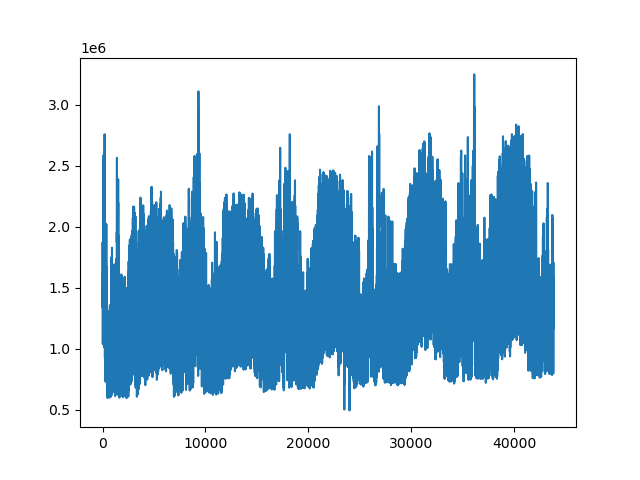

In [6]:
plt.figure()
plt.plot(df.Load)
plt.show()

In [7]:
df['y_cos_m'] = np.cos(2 * np.pi * df.Month / 12)
df['y_sin_m'] = np.sin(2 * np.pi * df.Month / 12)

df['y_cos_d'] = np.cos(2 * np.pi * df.Day / 365)
df['y_sin_d'] = np.sin(2 * np.pi * df.Day / 365)

df['y_cos_wd'] = np.cos(2 * np.pi * df.Weekday / 7)
df['y_sin_wd'] = np.sin(2 * np.pi * df.Weekday / 7)

In [8]:
import plotly.graph_objects as px

In [9]:
px.Figure([
  px.Scatter(x = df.index, y = df.y_cos_m, mode='lines', name = 'y_cos_m'),
  px.Scatter(x = df.index, y = df.y_sin_m, mode='lines', name = 'y_sin_m'),
  px.Scatter(x = df.index, y = df.y_cos_d, mode='lines', name = 'y_cos_d'),
  px.Scatter(x = df.index, y = df.y_sin_d, mode='lines', name = 'y_sin_d'),
  px.Scatter(x = df.index, y = df.y_cos_wd, mode='lines', name = 'y_cos_wd'),
  px.Scatter(x = df.index, y = df.y_sin_wd, mode='lines', name = 'y_sin_wd')
])

## Functions

### Sample selection

In [10]:
def trunc(values, decs=0):
    return np.trunc(values*10**decs)/(10**decs)

In [11]:
def diff(list1,list2):
    difference = []
    zip_object = zip(list1, list2)
    for list1_i, list2_i in zip_object:
        difference.append(list1_i-list2_i)
    return difference

In [12]:
def print_serie2(serie_,prototipo_,title_,ytitle_,xtitle_,sizex_=8,sizey_=5,namefile_='results.png'):
    CYAN = '#76ced6' ; LILA = '#777bd4'; VERDE='#17cb49'; NARA='#ff8000'; AZUL='#168fff'; OTROAZUL = "b-"; ROJO= "r-"; MAGE="FF00FF";
    fig, ax1 = plt.subplots(figsize=(sizex_,sizey_))
    plt.title(title_,fontsize='x-large',color=NARA)
    ax1.set_xlabel(xtitle_, color=NARA, fontsize='large')
    ax1.set_ylabel(ytitle_, color=NARA, fontsize='large')
    plt.tick_params(colors = NARA, which='both')
    ax1.spines['bottom'].set_color(NARA)
    ax1.spines['top'   ].set_color(NARA) 
    ax1.spines['right' ].set_color(NARA)
    ax1.spines['left'  ].set_color(NARA)
    if len(prototipo_) != 0: 
        plt.plot(prototipo_,alpha=0.6, linestyle='dashed', color='red', linewidth=3)
    for p in serie_:
        plt.plot(p,alpha=0.3, linewidth=2)    
    plt.savefig(namefile_, transparent=True)         
    plt.show()

In [13]:
def OLSstep(X, Y, X_2, pi_step_=0.001,verbose_=False):
    model   = sm.OLS(Y, X)
    results = model.fit()
    prediction_Y2 = results.predict(X_2)

    ## We sort the 'pi' values and the largest one is selected.
    i = 0
    pvalues = []
    for pi in results.pvalues:
        pvalues.append((i,pi))
        i = i + 1
    pvalues.sort(key=lambda tup: tup[1], reverse=True) ## We order by 'pi'
    (i, pi) = pvalues[0]  

    while pi > pi:
        X   = sm.add_constant(X)
        X_2 = sm.add_constant(X_2)   
        if verbose_==True:
            print('Retiramos regresor ---> X' + str(i))
        X   = np.delete(arr=X,   obj=i+0, axis=1)
        X_2 = np.delete(arr=X_2, obj=i+0, axis=1)   
        model   = sm.OLS(Y, X)
        results = model.fit()

        ## We sort the 'pi' values and select the largest
        i = 0
        pvalues = []
        for pi in results.pvalues:
            pvalues.append((i,pi))
            i = i + 1
        pvalues.sort(key=lambda tup: tup[1], reverse=True) ## We order by 'pi'
        (i, pi) = pvalues[0]
        #prediction   = results.predict(X)  
        prediction_Y2 = results.predict(X_2)
    if len(prediction_Y2) == 0:      
        if verbose_==True:
            print('>>> Warning, no variable was significant in the regression.')
        model   = sm.OLS(Y, X)
        results = model.fit()
        prediction_Y2 = results.predict(X_2)
        
    if verbose_==True:
        print(results.summary())
    return prediction_Y2   

In [14]:
def RF(X, Y, X_2,typedist_,verbose_=False):
    model         = RandomForestRegressor(random_state=42)
    results       = model.fit(X, Y)
    prediction_Y2 = results.predict(X_2)
    return prediction_Y2   
def Boosting(X, Y, X_2,typedist_,verbose_=False):
    model         = GradientBoostingRegressor(random_state=42,)
    results       = model.fit(X, Y)
    prediction_Y2 = results.predict(X_2)
    return prediction_Y2
def Bagging(X, Y, X_2,typedist_,verbose_=False):
    model         = BaggingRegressor(random_state=42,)
    results       = model.fit(X, Y)
    prediction_Y2 = results.predict(X_2)
    return prediction_Y2   
def AdaBoost(X, Y, X_2,typedist_,verbose_=False):
    model         = AdaBoostRegressor(random_state=42,)
    results       = model.fit(X, Y)
    prediction_Y2 = results.predict(X_2)
    return prediction_Y2 
def LinearReg(X, Y, X_2,typedist_,verbose_=False):
    model         = LinearRegression()
    results       = model.fit(X, Y)
    prediction_Y2 = results.predict(X_2)
    return prediction_Y2
def BayesRidge(X, Y, X_2,typedist_,verbose_=False):
    model         = BayesianRidge(compute_score=True)
    results       = model.fit(X, Y)
    prediction_Y2 = results.predict(X_2) 
    return prediction_Y2
def LassoReg(X, Y, X_2,typedist_,verbose_=True):
    model         = Lasso(alpha=0.1)
    results       = model.fit(X, Y)
    prediction_Y2 = results.predict(X_2)
    return prediction_Y2
def RidgeReg(X, Y, X_2,typedist_,verbose_=False):
    model         = Ridge(alpha=0.1)
    results       = model.fit(X, Y)
    prediction_Y2 = results.predict(X_2)
    return prediction_Y2    
def PLS(X, Y, X_2,n_components,typedist_,verbose_=False):
    model         = PLSRegression(n_components=n_components)
    results       = model.fit(X, Y)
    prediction_Y2 = results.predict(X_2)
    return prediction_Y2
def PCR(X, Y, X_2,n_components,typedist_,verbose_=False):
## https://scikit-learn.org/stable/auto_examples/cross_decomposition/plot_pcr_vs_pls.html
    model         = make_pipeline(PCA(n_components=n_components), LinearRegression())
    results       = model.fit(X, Y)
    prediction_Y2 = results.predict(X_2)
    return prediction_Y2

In [15]:
def VotingEnsemble(X, Y, X_2,verbose_=False):  
    ## https://scikit-learn.org/stable/auto_examples/ensemble/plot_voting_regressor.html#sphx-glr-auto-examples-ensemble-plot-voting-regressor-py
    gb  = GradientBoostingRegressor(random_state=42)
    rf  = RandomForestRegressor(random_state=42)
    br  = BaggingRegressor(random_state=42)
    ab  = AdaBoostRegressor(random_state=42)
    gb.fit(X, Y)
    rf.fit(X, Y)
    br.fit(X, Y)
    ab.fit(X, Y)
    voting = VotingRegressor([("gb",gb), ("rf",rf), ("br",br), ("ab",ab)])
    voting.fit(X, Y)
    prediction_Y2 = voting.predict(X_2)
    return prediction_Y2   

In [16]:
def VotingLinear(X, Y, X_2,verbose_=False):  
    ## https://scikit-learn.org/stable/auto_examples/ensemble/plot_voting_regressor.html#sphx-glr-auto-examples-ensemble-plot-voting-regressor-py
    pl = PLSRegression(n_components=1)
    lr = LinearRegression()
    ri = Ridge(alpha=0.1)
    la = Lasso(alpha=0.1)    
    pc = make_pipeline(PCA(n_components=1), LinearRegression())
    pl.fit(X, Y)
    lr.fit(X, Y)
    ri.fit(X, Y)
    la.fit(X, Y)
    pc.fit(X, Y)
    voting = VotingRegressor([("lr",lr),("ri",ri),("la",la),("pc",pc)]) #,("pl",pl)
    voting.fit(X, Y)
    prediction_Y2 = voting.predict(X_2)    
    return prediction_Y2   

In [17]:
def euclidean(neig1, neig2):
	distance = 0.0
	for i in range(len(neig1)):
		distance += (neig1[i] - neig2[i])**2
	return np.sqrt(distance)

### Forecast

#### AnMA

In [18]:
def analog_knn(serie,vsele,k=10,tol=0.8,n_components=3,typedist='pearson',typereg='OLSstep',verbose=False):
# vesele   : Size of the selection window / Tamanio de la ventana de selección
# k        : Number of neighbours to search for k / Número de vecinos a buscar k
# tol      : Window size tolerance for neighbour selection / Tolerancia de tamaño de ventanas para seleccion de vecinos
# typedist : distance measure, 'euclidian' or 'pearson' or 'dtw' / medida de distancia, 'euclidian' o 'pearson' o 'dtw' 
    t_o = time.time()
    n = len(serie) 

## STEP 1: Selection of the windows with the highest correlation.

    ## Calculate the distance between all neighbors.
    distances = []
    Y = serie[n-vsele:n]           ## latest data
    for i in range(n-2*vsele):                              
        if  typedist == 'dtw':     ## dynamic time warping
            dist = dtw(Y, serie[i:i+vsele]).distance  
        elif typedist == 'euclidian':
            dist = euclidean(Y,serie[i:i+vsele])
        else:
            dist = np.corrcoef(Y,serie[i:i+vsele])[1,0]
        if dist > 0:
            distances.append((i, dist))
        
    ## We calculate the neighbourhood by distance from smallest to largest and the positions are saved.
    if typedist == 'pearson':
        ## In the Pearson backwards case, we are interested in the indices with the highest correlation in Pearson backwards ordering.
        distances.sort(key=lambda tup: tup[1], reverse=True)
    else:
        distances.sort(key=lambda tup: tup[1], reverse=False)

    neighbors  = []
    neighbors2 = []
    positions  = []

    ## We calculate the k nearest neighbors and save the positions.
    i = 0
    for pos, dis in distances:
        if i==0:      
            positions.append(pos)   
            neighbors.append(serie[pos:pos+vsele])
            neighbors2.append(serie[pos+vsele:pos+2*vsele])  
        else:
            bandera = True
            for p in positions:
                 ## if we already had a position in the list that passed the tolerance, we no longer save it
                if (abs(pos - p) < tol*vsele):
                    bandera = False
                    i = i - 1
                    break
            if bandera == True:
                ## save new neighbor
                positions.append(pos)   
                neighbors.append(serie[pos:pos+vsele])
                neighbors2.append(serie[pos+vsele:pos+2*vsele])  
                bandera = False
        i = i + 1
        if i == k:
            break
    if verbose==True:
        print('positions KNN:', positions) ## position of k nearest neighbors

    neighbors  = np.array(neighbors)  
    neighbors2 = np.array(neighbors2)    
    vacia = []
    if verbose==True:
        print_serie2(neighbors,Y,'Selección con KNN:'+typedist,'demanda','time',8,5,'fig_t16_X_'+typedist+'_'+typereg)

    t_sel = time.time() - t_o

## STEP 2: Regression between nearest neighbors 'X' and last window 'Y'

    ## Define our regressors
    X   = (neighbors.T ).tolist()
    X_2 = (neighbors2.T).tolist()
    Y   = (Y).tolist()
    prediction_Y2 = []

    ## -- Random forest regression --
    if typereg == 'RF':
        prediction_Y2 = RF(X,Y,X_2,labels_=positions,typedist_=typedist,verbose_=verbose)

    ## -- OLS with Stepwise --
    if typereg == 'OLSstep':
        prediction_Y2 = OLSstep(X,Y,X_2, pi_step_=0.001,verbose_=verbose)

    ## -- Gradiant boosting regression --
    if typereg == 'Boosting':
        prediction_Y2 = Boosting(X, Y, X_2,typedist_=typedist,verbose_=verbose)   

    ## -- Bagging regression --
    if typereg == 'Bagging':
        prediction_Y2 = Bagging(X, Y, X_2,typedist_=typedist,verbose_=verbose)   

    ## -- Linear regression --
    if typereg == 'LinearReg':
        prediction_Y2 = LinearReg(X, Y, X_2,typedist_=typedist,verbose_=verbose)   

    ## -- Ada boosting --
    if typereg == 'AdaBoost':
        prediction_Y2 = AdaBoost(X, Y, X_2,typedist_=typedist,verbose_=verbose)  

    ## -- Bayesian Ridge --
    if typereg == 'BayesRidge':
        prediction_Y2 = BayesRidge(X, Y, X_2,typedist_=typedist,verbose_=verbose)  

    ## -- Lasso regression --
    if typereg == 'LassoReg':
        prediction_Y2 = LassoReg(X, Y, X_2,typedist_=typedist,verbose_=verbose)   

    ## -- Ridge regression --
    if typereg == 'RidgeReg':
        prediction_Y2 = RidgeReg(X, Y, X_2,typedist_=typedist,verbose_=verbose)

    ## -- PLS Regression --
    if typereg == 'PLS':
        prediction_Y2 = PLS(X, Y, X_2,n_components=n_components,typedist_=typedist,verbose_=verbose)

    ## -- PCA Regression --
    if typereg == 'PCR':
        prediction_Y2 = PCR(X, Y, X_2,n_components=n_components,typedist_=typedist,verbose_=verbose)

    ## -- Voting regression with ensemble models -- 
    if typereg == 'VotingEnsemble':
        prediction_Y2 = VotingEnsemble(X,Y,X_2,verbose_=verbose)

    ## -- Voting regression with linear model -- 
    if typereg == 'VotingLinear':
        prediction_Y2 = VotingLinear(X,Y,X_2,verbose_=verbose)
        
    ## -- Random forrest regression with GridSearchCV--
    #if typereg == 'AutoRF':
    #    prediction_Y2 = AutoRF(X, Y, X_2,labels_=positions,typedist_=typedist,verbose_=verbose)        

    if verbose==True:
        print_serie2(neighbors2,prediction_Y2, 'Forecast - ' + typedist+' - ' + typereg ,'Demand','Time',8,5,'fig_t16_Y2_'+typedist+'_'+typereg)

    t_reg = time.time() - t_sel - t_o
    fail_=False
    if len(prediction_Y2) == 0:
        prediction_Y2=[serie[-1]] * vsele
        fail_=True
        print(">>> analogo_knn: Forecast not calculated.")

    ## Draw an example of an analogous space with X, X' and Y,Y'
    if False:
        fig, ax = plt.subplots(figsize=(8,5))
        ax.legend(['First line', 'Second line'])
        serie1=serie[positions[0]:positions[0]+2*vsele]
        serie2=serie[positions[1]:positions[1]+2*vsele]
        serie3=serie[positions[2]:positions[2]+2*vsele]
        serie4=serie[positions[3]:positions[3]+2*vsele]
        serie5=serie[positions[4]:positions[4]+2*vsele]
        serie6=serie[positions[5]:positions[5]+2*vsele]
        ax.plot(serie1, label='X$_1$')
        ax.plot(serie2, label='X$_2$')
        ax.plot(serie3, label='X$_3$')
        ax.plot(serie4, label='X$_4$')
        ax.plot(serie5, label='X$_5$')
        ax.plot(serie6,label='X$_6$')
        ax.plot(Y,label='Y', linewidth=3, color='r')   
        c = np.concatenate((Y,prediction_Y2), axis=0)   
        ax.plot(c, label='$Y\'$', linewidth=3, color='r',linestyle='--')      
        plt.legend()
        plt.axvline(x = vsele,linestyle='-.') # '-', '--', '-.', ':',
        ax.set(xlabel='time (5 min)', ylabel='demand (MW)') #title='High correlation windows'
        ax.grid()

        fig.savefig('test'+str(random.randint(1,30000))+'.pdf')
        plt.show()

    return prediction_Y2, t_sel, t_reg, fail_

#### Bivariate AnMA

In [19]:
def analog_bivariate(
    X, X_ref, Y,
    k = 10, tol=0.8, n_components=3,
    typedist='pearson', typereg='OLSstep', 
    verbose=False):
    """
    X_ref: Serie de referencia (temp)
    X: Serie donde se buscarán los más semejantes a X_ref (temp)
    Y: Objetivo a pronosticar (load)
    k        : Number of neighbours to search for k / Número de vecinos a buscar k
    tol      : Window size tolerance for neighbour selection / Tolerancia de tamaño de ventanas para seleccion de vecinos
    typedist : distance measure, 'euclidian' or 'pearson' or 'dtw' / medida de distancia, 'euclidian' o 'pearson' o 'dtw' 
    """
    distances = []
    for i in range(0, len(X) - len(X_ref)): # No hay esa restricción :o
        if  typedist == 'dtw':     ## dynamic time warping
            dist = dtw(X_ref, X[i, i + len(X_ref)]).distance
        elif typedist == 'euclidian':
            dist = euclidean(X_ref, X[i : i + len(X_ref)])
        else:
            dist = np.corrcoef(X_ref, X[i : i + len(X_ref)])[1,0]
        distances.append((i, dist))

    ## We calculate the neighbourhood by distance from smallest to largest and the positions are saved.
    if typedist == 'pearson':
        ## In the Pearson backwards case, we are interested in the indices with the highest correlation in Pearson backwards ordering.
        distances.sort(key=lambda tup: tup[1], reverse=True)
    else:
        distances.sort(key=lambda tup: tup[1], reverse=False)

    neighbors  = []
    neighbors2 = []
    positions  = []

    ## We calculate the k nearest neighbors and save the positions.
    for pos, dis in distances:
        if len(positions) == 0:
            positions.append(pos)
            neighbors.append(X[pos:pos + len(X_ref)])
            neighbors2.append(X[pos + len(X_ref) : pos + 2 * len(X_ref)])
        else:
            for p in positions:
                 ## if we already had a position in the list that passed the tolerance, we no longer save it
                if (abs(pos - p) < tol * len(X_ref)):
                    break
                else:
                    ## save new neighbor
                    positions.append(pos)
                    neighbors.append(X[pos:pos + len(X_ref)])
                    neighbors2.append(X[pos + len(X_ref) : pos + 2 * len(X_ref)])
        if len(positions) >= k:
            break
    if verbose == True:
        print('positions KNN:', positions) ## position of k nearest neighbors

    neighbors  = np.array(neighbors)
    neighbors2 = np.array(neighbors2)
    if verbose==True:
        print_serie2(neighbors, X_ref, 'Selección con KNN:'+typedist,'demanda','tiempo',
        8,5,'unit_test'+typedist+'_'+typereg)

## STEP 2: Regression between nearest neighbors 'X' and last window 'Y'

    ## Define our regressors
    X   = neighbors.T
    X_1 = neighbors2.T
    Y_cap = []

    print(X)

    ## -- Random forest regression --
    if typereg == 'RF':
        Y_cap = RF(X, Y, X_1, typedist_=typedist, verbose_=verbose)

    ## -- OLS with Stepwise --
    if typereg == 'OLSstep':
        Y_cap = OLSstep(X, Y, X_1, pi_step_=0.001, verbose_=verbose)

    ## -- Gradiant boosting regression --
    if typereg == 'Boosting':
        Y_cap = Boosting(X, Y, X_1,typedist_=typedist,verbose_=verbose)

    ## -- Bagging regression --
    if typereg == 'Bagging':
        Y_cap = Bagging(X, Y, X_1,typedist_=typedist,verbose_=verbose)

    ## -- Linear regression --
    if typereg == 'LinearReg':
        Y_cap = LinearReg(X, Y, X_1,typedist_=typedist,verbose_=verbose)

    ## -- Ada boosting --
    if typereg == 'AdaBoost':
        Y_cap = AdaBoost(X, Y, X_1,typedist_=typedist,verbose_=verbose)

    ## -- Bayesian Ridge --
    if typereg == 'BayesRidge':
        Y_cap = BayesRidge(X, Y, X_1,typedist_=typedist,verbose_=verbose)

    ## -- Lasso regression --
    if typereg == 'LassoReg':
        Y_cap = LassoReg(X, Y, X_1,typedist_=typedist,verbose_=verbose)

    ## -- Ridge regression --
    if typereg == 'RidgeReg':
        Y_cap = RidgeReg(X, Y, X_1,typedist_=typedist,verbose_=verbose)

    ## -- PLS Regression --
    if typereg == 'PLS':
        Y_cap = PLS(X, Y, X_1,n_components=n_components,typedist_=typedist,verbose_=verbose)

    ## -- PCA Regression --
    if typereg == 'PCR':
        Y_cap = PCR(X, Y, X_1,n_components=n_components,typedist_=typedist,verbose_=verbose)

    ## -- Voting regression with ensemble models -- 
    if typereg == 'VotingEnsemble':
        Y_cap = VotingEnsemble(X,Y,X_1,verbose_=verbose)

    ## -- Voting regression with linear model -- 
    if typereg == 'VotingLinear':
        Y_cap = VotingLinear(X,Y,X_1,verbose_=verbose)

    ## -- Random forrest regression with GridSearchCV--
    #if typereg == 'AutoRF':
    #    Y_cap = AutoRF(X, Y, X_1,labels_=positions,typedist_=typedist,verbose_=verbose)

    if verbose==True:
        print_serie2(neighbors2,Y_cap, 'Forecast - ' + typedist+' - ' + typereg ,'Demand','Time',8,5,'fig_t16_Y2_'+typedist+'_'+typereg)

    if len(Y_cap) == 0:
        print(">>> analogo_knn: Forecast not calculated.")

    return Y_cap

#### AnMA Calendar

In [20]:
def analog_calen(X, X_1, Y,
    k=10, tol=0.8, n_components=3, typedist='pearson', 
    typereg='OLSstep', verbose=False):
    # X (array): Array of columns names for endogenous variables, i.e. ['T1', 'T2', ...]
    # X_1 (str): Column name of the variable to be forecasted, i.e. 'Load'
    # vesele   : Size of the selection window / Tamanio de la ventana de selección
    # k        : Number of neighbours to search for k / Número de vecinos a buscar k
    # tol      : Window size tolerance for neighbour selection / Tolerancia de tamaño de ventanas para seleccion de vecinos
    # typedist : distance measure, 'euclidian' or 'pearson' or 'dtw' / medida de distancia, 'euclidian' o 'pearson' o 'dtw' 

## STEP 2: Regression between nearest neighbors 'X' and last window 'Y'

    ## Define our regressors
    X   = X
    X_1 = X_1
    Y   = Y
    Y_cap = []

    ## -- Random forest regression --
    if typereg == 'RF':
        Y_cap = RF(X, Y, X_1, typedist_=typedist, verbose_=verbose)

    ## -- OLS with Stepwise --
    if typereg == 'OLSstep':
        Y_cap = OLSstep(X, Y, X_1, pi_step_=0.001, verbose_=verbose)

    ## -- Gradiant boosting regression --
    if typereg == 'Boosting':
        Y_cap = Boosting(X, Y, X_1,typedist_=typedist,verbose_=verbose)   

    ## -- Bagging regression --
    if typereg == 'Bagging':
        Y_cap = Bagging(X, Y, X_1,typedist_=typedist,verbose_=verbose)   

    ## -- Linear regression --
    if typereg == 'LinearReg':
        Y_cap = LinearReg(X, Y, X_1,typedist_=typedist,verbose_=verbose)   

    ## -- Ada boosting --
    if typereg == 'AdaBoost':
        Y_cap = AdaBoost(X, Y, X_1,typedist_=typedist,verbose_=verbose)  

    ## -- Bayesian Ridge --
    if typereg == 'BayesRidge':
        Y_cap = BayesRidge(X, Y, X_1,typedist_=typedist,verbose_=verbose)  

    ## -- Lasso regression --
    if typereg == 'LassoReg':
        Y_cap = LassoReg(X, Y, X_1,typedist_=typedist,verbose_=verbose)   

    ## -- Ridge regression --
    if typereg == 'RidgeReg':
        Y_cap = RidgeReg(X, Y, X_1,typedist_=typedist,verbose_=verbose)

    ## -- PLS Regression --
    if typereg == 'PLS':
        Y_cap = PLS(X, Y, X_1,n_components=n_components,typedist_=typedist,verbose_=verbose)

    ## -- PCA Regression --
    if typereg == 'PCR':
        Y_cap = PCR(X, Y, X_1,n_components=n_components,typedist_=typedist,verbose_=verbose)

    ## -- Voting regression with ensemble models -- 
    if typereg == 'VotingEnsemble':
        Y_cap = VotingEnsemble(X,Y,X_1,verbose_=verbose)

    ## -- Voting regression with linear model -- 
    if typereg == 'VotingLinear':
        Y_cap = VotingLinear(X,Y,X_1,verbose_=verbose)
        
    ## -- Random forrest regression with GridSearchCV--
    #if typereg == 'AutoRF':
    #    Y_cap = AutoRF(X, Y, X_1,labels_=positions,typedist_=typedist,verbose_=verbose)        

    if verbose==True:
        print_serie2(X_1,Y_cap, 'Forecast - ' + typedist+' - ' + typereg ,'Demand','Time',8,5,'fig_t16_Y2_'+typedist+'_'+typereg)

    if len(Y_cap) == 0:
        print(">>> analogo_knn: Forecast not calculated.")

    ## Draw an example of an analogous space with X, X' and Y,Y'
    if False:
        fig, ax = plt.subplots(figsize=(8,5))
        ax.legend(['First line', 'Second line'])
        serie1=serie[positions[0]:positions[0]+2*vsele]
        serie2=serie[positions[1]:positions[1]+2*vsele]
        serie3=serie[positions[2]:positions[2]+2*vsele]
        serie4=serie[positions[3]:positions[3]+2*vsele]
        serie5=serie[positions[4]:positions[4]+2*vsele]
        serie6=serie[positions[5]:positions[5]+2*vsele]
        ax.plot(serie1, label='X$_1$')
        ax.plot(serie2, label='X$_2$')
        ax.plot(serie3, label='X$_3$')
        ax.plot(serie4, label='X$_4$')
        ax.plot(serie5, label='X$_5$')
        ax.plot(serie6,label='X$_6$')
        ax.plot(Y,label='Y', linewidth=3, color='r')   
        c = np.concatenate((Y,Y_cap), axis=0)   
        ax.plot(c, label='$Y\'$', linewidth=3, color='r',linestyle='--')      
        plt.legend()
        plt.axvline(x = vsele,linestyle='-.') # '-', '--', '-.', ':',
        ax.set(xlabel='time (5 min)', ylabel='demand (MW)') #title='High correlation windows'
        ax.grid()

        fig.savefig('test'+str(random.randint(1,30000))+'.pdf')
        plt.show()

    return Y_cap

#### Persistence

In [21]:
## Persistence forecasting
def persistence(serie, n=1):
  out = [serie[-1] * n]
  return(out)

#### Autoarima

In [22]:
def sk_autoarima(x, max_p = 2, max_d = 2, max_q = 2, sp = 1, to_predict = 1):
  forecaster = AutoARIMA(
    start_p = 0, d = 0, start_q = 0, 
    max_p = max_p, max_d = max_d, max_q = max_q, 
    sp = sp,
    suppress_warnings = True
  )
  # Una semana dos horas antes es 2016 + 24 = 2040
  forecaster.fit(x)

  y_pred = forecaster.predict(fh=list(range(1, to_predict + 1)))
  return(y_pred)

#### Holter-Winters

In [23]:
def HoltWinters(data,vsele,option='Additive'):
  ##'Additive' 'Multiplicative' 'Additive Dam' 'Multiplicative Dam'
##https://www.statsmodels.org/dev/examples/notebooks/generated/exponential_smoothing.html#Holt%E2%80%99s-Winters-Seasonal
  if option == 'Additive':
    fit = ExponentialSmoothing(
    data,
    seasonal_periods      = vsele,
    trend                 = "add",
    seasonal              = "add",
    use_boxcox            = True,
    initialization_method ="estimated").fit()
  elif option == 'Multiplicative':
    fit = ExponentialSmoothing(
    data,
    seasonal_periods      = vsele,
    trend                 = "add",
    seasonal              = "mul",
    use_boxcox            = True,
    initialization_method = "estimated").fit()
  elif option == 'Additive Dam':
    fit = ExponentialSmoothing(
    data,
    seasonal_periods      = vsele,
    trend                 = "add",
    seasonal              = "add",
    damped_trend          = True,
    use_boxcox            = True,
    initialization_method = "estimated").fit()
  elif option == 'Multiplicative Dam':
    fit = ExponentialSmoothing(
    data,
    seasonal_periods      = vsele,
    trend                 = "add",
    seasonal              = "mul",
    damped_trend          = True,
    use_boxcox            = True,
    initialization_method = "estimated").fit()
  return fit.forecast(vsele)

### Utilities

In [24]:
## Function that given a datetime, returns its position in the series.
def get_index_day(df,day,month,year):
    df_i = df.reset_index()  ## Integer indices are added.
    idxo = df_i[(df_i.Date.dt.day == day) & (df_i.Date.dt.month==month) & (df_i.Date.dt.year==year)].iloc[ 0]
    idxf = df_i[(df_i.Date.dt.day == day) & (df_i.Date.dt.month==month) & (df_i.Date.dt.year==year)].iloc[-1]
    return(idxo.name, idxf.name)

In [25]:
def get_day_from_index(df, indices, forecast):
    """
    Parameters
    ----------
    df : DataFrame
        Original dataframe of the timeseries
    indices : array
        Array of indices
    
    Returns
    -------
    DataFrame
        A DataFrame of dates
    """
    df_i = df.reset_index()  ## Integer indices are added.
    sel_date = df_i.iloc[indices].Date
    t = pd.concat([sel_date.reset_index(), pd.Series(forecast)], axis=1)
    t = t.rename(columns={0 : 'value'})
    return(t)

# Forecasts

## Bivariate AnMA 

### Unit test

Forecast jan-2016

#### Data selection

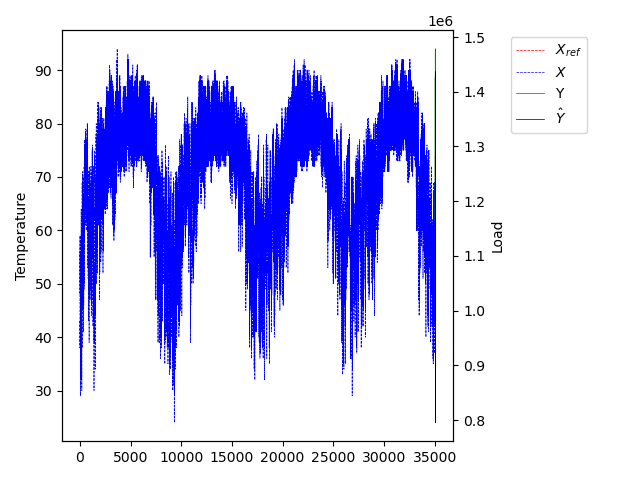

In [29]:
# 744 horas un mes
# 8760 horas es un año
i0_2006 = df[(df.Year == 2006)].index[0]

Y_cap = df[i0_2006 : i0_2006 + 24].Load

X_ref = df[Y_cap.index[0] - len(Y_cap) : Y_cap.index[0]].T1
X = df[(df.index < X_ref.index[0])].T1
Y = df[Y_cap.index[0] - len(Y_cap) : Y_cap.index[0]].Load

plt.figure()
ax = plt.gca()
p1 = ax.plot(X_ref, '--r', label='$X_{ref}$', linewidth = 0.5)
p2 = ax.plot(X, '--b', label = '$X$', linewidth = 0.5)
ax.set_ylabel('Temperature')
ax2 = ax.twinx()
p3 = ax2.plot(Y, '-g', label = 'Y', linewidth = 0.5)
p4 = ax2.plot(Y_cap, '-k', label = '$\hat{Y}$', linewidth = 0.5)
ax2.set_ylabel('Load')

# https://stackoverflow.com/a/5487005
plots = p1 + p2 + p3 + p4
labels = [l.get_label() for l in plots]
ax.legend(plots, labels, bbox_to_anchor=(1.36, 1))
plt.tight_layout()
plt.show()

#### Model

In [42]:
m = AnalogBivariate(X, X_ref, Y, reg_model= 'RF')
m.fit()
m.predict()

[]

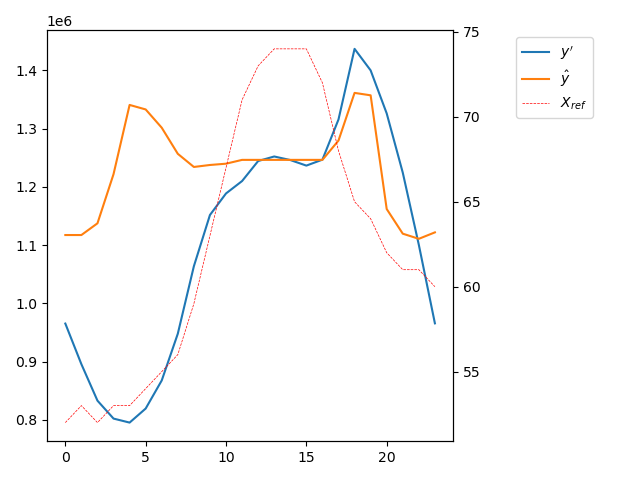

In [43]:
plt.figure()
ax = plt.gca()
p1 = ax.plot(np.array(Y_cap), label = '$y\'$')
p2 = ax.plot(m.Y_hat, label = '$\hat{y}$')

ax2 = ax.twinx()
p3 = ax2.plot(np.array(X_ref), '--r', label='$X_{ref}$', linewidth = 0.5)

plots = p1 + p2 + p3
labels = [l.get_label() for l in plots]
ax.legend(plots, labels, bbox_to_anchor=(1.36, 1))
plt.tight_layout()
plt.plot()

### Model

In [ ]:
# Por si queremos hacerlo por días
'''
d = -1
for r in rows:
    if d < 0:
        d = r.Day
    elif d != r.Day:
        # cambió de día
'''

In [3]:
df[(df.Year == 2007)]

,Year,Month,Day,Weekday,Hour,T1,T2,T3,T4,Load
43824,2007,1,1,2,1,69,70.0,73.0,64.0,NaN
43825,2007,1,1,2,2,68,69.0,73.0,64.0,NaN
43826,2007,1,1,2,3,68,68.0,73.0,64.0,NaN
43827,2007,1,1,2,4,67,68.0,72.0,63.0,NaN
43828,2007,1,1,2,5,67,68.0,72.0,63.0,NaN
...,...,...,...,...,...,...,...,...,...,...
52579,2007,12,31,2,20,66,66.0,75.0,55.0,NaN
52580,2007,12,31,2,21,65,66.0,75.0,54.0,NaN
52581,2007,12,31,2,22,64,64.0,77.0,52.0,NaN
52582,2007,12,31,2,23,63,63.0,75.0,50.0,NaN


In [4]:
i_0_2007 = df[(df.Year == 2007)].index[0]
i_0_2007

43824

In [5]:
i_f_2007 = df[(df.Year == 2007)].index[-1]
i_f_2007

52583

In [13]:
# El CAOS

i_0_2007 = df[(df.Year == 2006)].index[0]
i_f_2007 = df[(df.Year == 2006)].index[-1]
methods = ['Boosting']#['RF', 'Boosting', 'Bagging', 'LinearReg', 'AdaBoost', 'BayesRidge', 'LassoReg', 'RidgeReg', 'PLS', 'PCR', 'VotingEnsemble', 'VotingLinear']
i_f = i_0_2007 + 744
results = []
bandera = True
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    # 168 horas es una semana
    # 744 horas un mes
    # 8760 horas es un año
    for d in range(i_0_2007, i_0_2007 + 8760, 24):
        for i in range(d, d + 24):
            print(i - i_0_2007)
            Y_cap = df[i : i + 24].Load
            X_ref = df[Y_cap.index[0] - len(Y_cap) : Y_cap.index[0]].T1
            X = df[(df.index < X_ref.index[0])].T1
            if bandera:
                Y = df[Y_cap.index[0] - len(Y_cap) : Y_cap.index[0]].Load
                bandera = False

            model = AnalogBivariate(X, X_ref, Y, reg_model = 'Boosting')
            model.fit()
            model.predict()
            if not bandera: # Completa con los pronosticados del periodo anterior
                Y = model.Y_hat
            results.append(model.Y_hat[0])
        break


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23


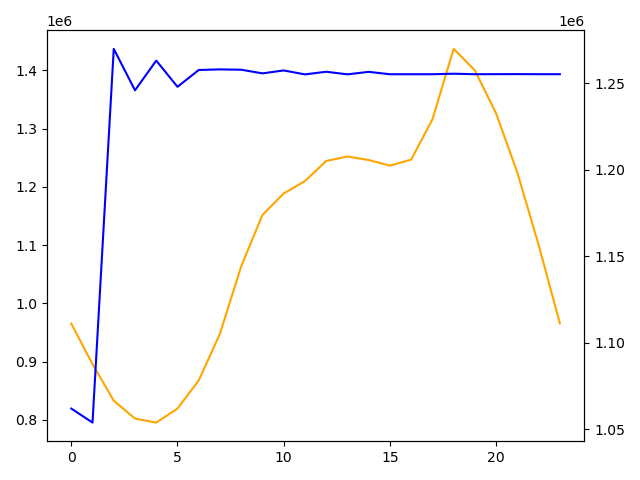

In [15]:
plt.figure()
ax = plt.gca()
ax.plot(df[i_0_2007 : i_0_2007 + 24].Load.values, label = '$y\'$', color = 'orange')
ax2 = ax.twinx()
ax2.plot(results, label = '$\hat{y}$', color = 'blue')
plt.tight_layout()
plt.show()

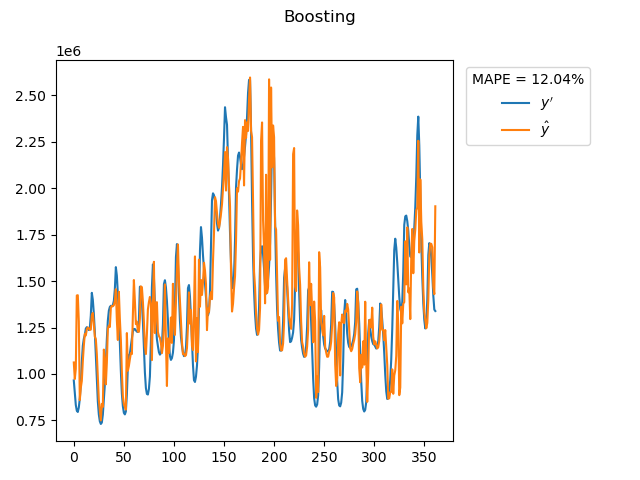

In [87]:
plt.figure()
plt.suptitle(me)
plt.plot(df[i0_2006 : i0_2006 + 362].Load.values, label = '$y\'$')
plt.plot(results0, label = '$\hat{y}$')
mape_p = mean_absolute_percentage_error(df[i0_2006 : i0_2006 + 362].Load.values, results0)
plt.legend(title = 'MAPE = ' + str(round(mape_p * 100, 2)) + '%', bbox_to_anchor=(1.36, 1))
plt.tight_layout()
plt.show()

## Calendar AnMA

### Unit test

Forecast jan-2016

#### Data selection

In [ ]:
# Enero de 2006
df_01_2006 = df[(df.Year == 2006) & (df.Month == 1)]
df_01_2006

,Year,Month,Day,Weekday,Hour,T1,T2,T3,T4,Load,y_cos_m,y_sin_m,y_cos_d,y_sin_d,y_cos_wd,y_sin_wd
35064,2006,1,1,1,1,60,60.0,68.0,55.0,965378.0,0.866025,0.5,0.999852,0.017213,0.623490,0.781831
35065,2006,1,1,1,2,60,60.0,68.0,54.0,895635.0,0.866025,0.5,0.999852,0.017213,0.623490,0.781831
35066,2006,1,1,1,3,60,60.0,67.0,54.0,833063.0,0.866025,0.5,0.999852,0.017213,0.623490,0.781831
35067,2006,1,1,1,4,59,60.0,68.0,52.0,802302.0,0.866025,0.5,0.999852,0.017213,0.623490,0.781831
35068,2006,1,1,1,5,59,61.0,68.0,51.0,795433.0,0.866025,0.5,0.999852,0.017213,0.623490,0.781831
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35803,2006,1,31,3,20,51,50.0,67.0,43.0,1641229.0,0.866025,0.5,0.860961,0.508671,-0.900969,0.433884
35804,2006,1,31,3,21,49,47.0,64.0,42.0,1647960.0,0.866025,0.5,0.860961,0.508671,-0.900969,0.433884
35805,2006,1,31,3,22,47,46.0,62.0,40.0,1630985.0,0.866025,0.5,0.860961,0.508671,-0.900969,0.433884
35806,2006,1,31,3,23,46,45.0,61.0,39.0,1546183.0,0.866025,0.5,0.860961,0.508671,-0.900969,0.433884


In [ ]:
# primer índice de enero de 2006 Y_cap
y_t_0 = df_01_2006.index[0]
print(y_t_0)

# último indice de enero de 2006 Y_cap
y_t_f = df_01_2006.index[-1]
print(y_t_f)

# Y_cap
y_cap = df.iloc[y_t_0:y_t_f + 1][['Load']]
print(y_cap)

# longitud del rango
delta_y_t = y_t_f - y_t_0
print(delta_y_t)

# Y anterior para 2005
y = df.iloc[y_t_0 - 1 - delta_y_t : y_t_0 - 1][['Load']]
print(y)

x = []
x_1 = []
# X1_2005
x_2005_t_0 = df[(df.Year == 2005) & (df.Month == 1)].index[0]
x_2005_t_f = df[(df.Year == 2005) & (df.Month == 1)].index[-1]
x_1.append(df.iloc[x_2005_t_0:x_2005_t_f][['T1', 'T2', 'T3', 'T4', 'Load']])
delta_x_2005_t = x_2005_t_f - x_2005_t_0
x.append(df.iloc[x_2005_t_0 - 1 - delta_x_2005_t : x_2005_t_0 - 1][['T1', 'T2', 'T3', 'T4', 'Load']]) # X_2004

# X1_2004
x_2004_t_0 = df[(df.Year == 2004) & (df.Month == 1)].index[0]
x_2004_t_f = df[(df.Year == 2004) & (df.Month == 1)].index[-1]
x_1.append(df.iloc[x_2004_t_0:x_2004_t_f][['T1', 'T2', 'T3', 'T4', 'Load']])
delta_x_2004_t = x_2004_t_f - x_2004_t_0
x.append(df.iloc[x_2004_t_0 - 1 - delta_x_2004_t : x_2004_t_0 - 1][['T1', 'T2', 'T3', 'T4', 'Load']]) # X_2003

# X1_2003
x_2003_t_0 = df[(df.Year == 2003) & (df.Month == 1)].index[0]
x_2003_t_f = df[(df.Year == 2003) & (df.Month == 1)].index[-1]
x_1.append(df.iloc[x_2003_t_0:x_2003_t_f][['T1', 'T2', 'T3', 'T4', 'Load']])
delta_x_2003_t = x_2003_t_f - x_2003_t_0
x.append(df.iloc[x_2003_t_0 - 1 - delta_x_2003_t : x_2003_t_0 - 1][['T1', 'T2', 'T3', 'T4', 'Load']]) # X_2002

35064
35807
            Load
35064   965378.0
35065   895635.0
35066   833063.0
35067   802302.0
35068   795433.0
...          ...
35803  1641229.0
35804  1647960.0
35805  1630985.0
35806  1546183.0
35807  1441889.0

[744 rows x 1 columns]
743
            Load
34320  1173425.0
34321  1161324.0
34322  1185265.0
34323  1233299.0
34324  1329294.0
...          ...
35058  1478396.0
35059  1409813.0
35060  1309493.0
35061  1217706.0
35062  1127940.0

[743 rows x 1 columns]


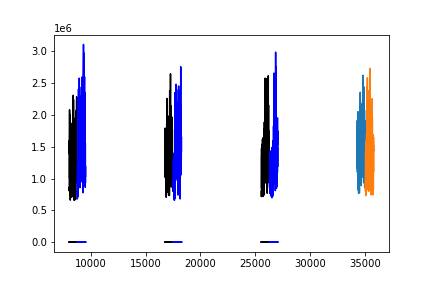

In [ ]:
plt.figure()
for i in x:
    plt.plot(i, c = 'black')
for i in x_1:
    plt.plot(i, c = 'blue')
plt.plot(y)
plt.plot(y_cap)
plt.show()

#### Model

In [ ]:
k               = 5          ## Number of nearest neighbors
tol             = 0.8        ## Closest tolerance percentage between neighbors
typedist        = 'pearson'  ## Distance betweeen neighbors: 'pearson' 'euclidian' 'lb_keogh' 'matrixprofile'
typereg         = 'OLSstep'  ## Regression model: 'OLSstep' 'Boosting' 'Bagging' 'LinearReg' 'AdaBoost' 'BayesRidge' 'LassoReg' 'RidgeReg' 'PLS' 'PCR' 'VotingEnsemble' 'VotingLinear'

In [ ]:
X = np.column_stack((x[0], x[1], x[2]))
X_1 = np.column_stack((x_1[0], x_1[1], x_1[2]))
Y = np.array(y)
Y_cap = np.array(y_cap)

In [ ]:
import AnalogBivariate

model = AnalogBivariate(X, X_1, Y)
model.fit()
model.predict()


[]

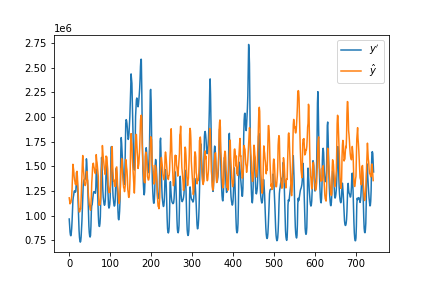

In [ ]:
## Analogue method parameters
pred_ = analog_calen(
    X, X_1, Y, k = k, tol = tol,
    typedist = typedist, typereg=typereg, verbose=False
)
pred_list  = pred_.tolist()

plt.figure()
plt.plot(Y_cap, label = '$y\'$')
plt.plot(pred_list, label = '$\hat{y}$')
plt.legend()
plt.plot()

### Data selection

In [ ]:
df[df.Year == 2006]

,Year,Month,Day,Weekday,Hour,T1,T2,T3,T4,Load,y_cos_m,y_sin_m,y_cos_d,y_sin_d,y_cos_wd,y_sin_wd
35064,2006,1,1,1,1,60,60.0,68.0,55.0,965378.0,0.866025,5.000000e-01,0.999852,0.017213,0.62349,0.781831
35065,2006,1,1,1,2,60,60.0,68.0,54.0,895635.0,0.866025,5.000000e-01,0.999852,0.017213,0.62349,0.781831
35066,2006,1,1,1,3,60,60.0,67.0,54.0,833063.0,0.866025,5.000000e-01,0.999852,0.017213,0.62349,0.781831
35067,2006,1,1,1,4,59,60.0,68.0,52.0,802302.0,0.866025,5.000000e-01,0.999852,0.017213,0.62349,0.781831
35068,2006,1,1,1,5,59,61.0,68.0,51.0,795433.0,0.866025,5.000000e-01,0.999852,0.017213,0.62349,0.781831
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43819,2006,12,31,1,20,71,72.0,77.0,65.0,1612494.0,1.000000,-2.449294e-16,0.860961,0.508671,0.62349,0.781831
43820,2006,12,31,1,21,70,72.0,75.0,65.0,1473990.0,1.000000,-2.449294e-16,0.860961,0.508671,0.62349,0.781831
43821,2006,12,31,1,22,70,71.0,75.0,65.0,1374181.0,1.000000,-2.449294e-16,0.860961,0.508671,0.62349,0.781831
43822,2006,12,31,1,23,69,70.0,74.0,65.0,1272117.0,1.000000,-2.449294e-16,0.860961,0.508671,0.62349,0.781831


In [ ]:
import warnings
from sklearn.metrics import mean_absolute_error,mean_squared_error,mean_absolute_percentage_error

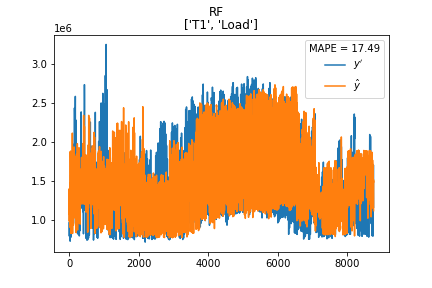

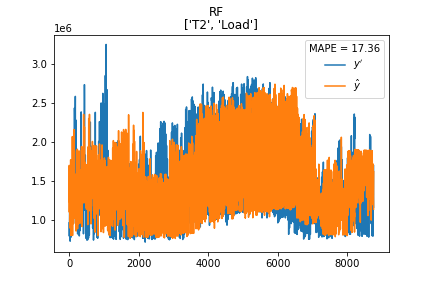

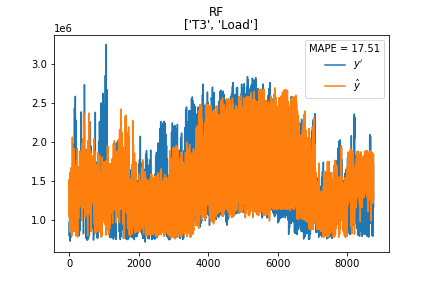

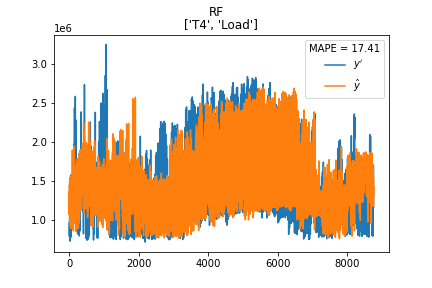

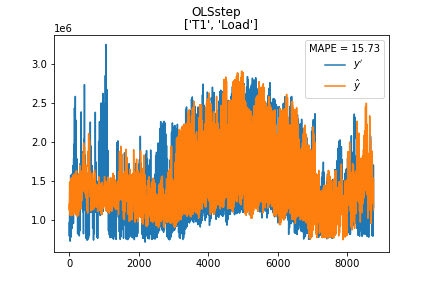

...

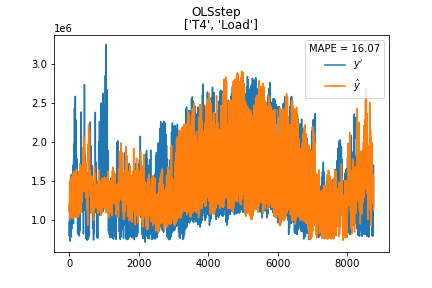

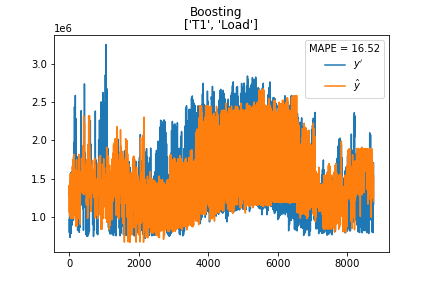

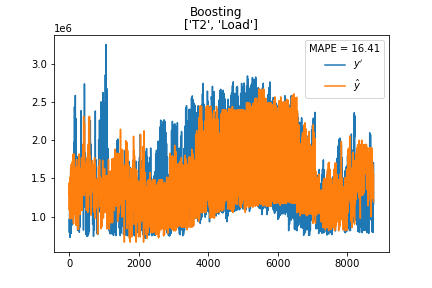

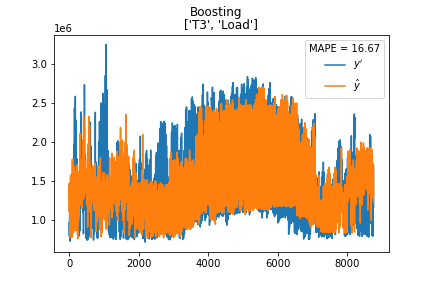

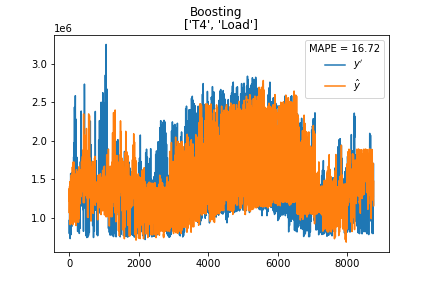

In [ ]:
k               = 5          ## Number of nearest neighbors
tol             = 0.8        ## Closest tolerance percentage between neighbors
typedist        = 'pearson'  ## Distance betweeen neighbors: 'pearson' 'euclidian' 'lb_keogh' 'matrixprofile'
typereg         = 'OLSstep'  ## Regression model: 'OLSstep' 'Boosting' 'Bagging' 'LinearReg' 'AdaBoost' 'BayesRidge' 'LassoReg' 'RidgeReg' 'PLS' 'PCR' 'VotingEnsemble' 'VotingLinear'

methods = ['RF', 'OLSstep', 'Boosting']
variables = [
    ['T1', 'Load'],
    ['T2', 'Load'],
    ['T3', 'Load'],
    ['T4', 'Load']
]
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    for me in methods:
        for v in variables:
            y_all = []
            results = []
            for m in range(1, 13):
                # primer índice de enero de 2006 Y_cap
                y_t_0 = df[(df.Year == 2006) & (df.Month == m)].index[0]

                # último indice de enero de 2006 Y_cap
                y_t_f = df[(df.Year == 2006) & (df.Month == m)].index[-1]
                
                # Y_cap
                y_cap = df.iloc[y_t_0:y_t_f + 1][['Load']]

                # longitud del rango
                delta_y_t = y_t_f - y_t_0

                # Y 2005
                y = df.iloc[y_t_0 - 1 - delta_y_t : y_t_0 - 1][['Load']]
                y_all.append(y_cap.values.flatten())

                x = []
                x_1 = []

                # X1_2005
                x_2005_t_0 = df[(df.Year == 2005) & (df.Month == m)].index[0]
                x_2005_t_f = x_2005_t_0 + delta_y_t
                x_1.append(df.iloc[x_2005_t_0:x_2005_t_f + 1][v])
                delta_x_2005_t = x_2005_t_f - x_2005_t_0
                x.append(df.iloc[x_2005_t_0 - 1 - delta_x_2005_t : x_2005_t_0 - 1][v]) # X_2004

                # X1_2004
                x_2004_t_0 = df[(df.Year == 2004) & (df.Month == m)].index[0]
                x_2004_t_f = x_2004_t_0 + delta_y_t
                x_1.append(df.iloc[x_2004_t_0:x_2004_t_f + 1][v])
                delta_x_2004_t = x_2004_t_f - x_2004_t_0
                x.append(df.iloc[x_2004_t_0 - 1 - delta_x_2004_t : x_2004_t_0 - 1][v]) # X_2003

                # X1_2003
                x_2003_t_0 = df[(df.Year == 2003) & (df.Month == m)].index[0]
                x_2003_t_f = x_2003_t_0 + delta_y_t
                x_1.append(df.iloc[x_2003_t_0:x_2003_t_f + 1][v])
                delta_x_2003_t = x_2003_t_f - x_2003_t_0
                x.append(df.iloc[x_2003_t_0 - 1 - delta_x_2003_t : x_2003_t_0 - 1][v]) # X_2002

                X = np.column_stack((x[0], x[1], x[2]))
                X_1 = np.column_stack((x_1[0], x_1[1], x_1[2]))
                Y = np.array(y)
                Y_cap = np.array(y_cap)

                pred_ = analog_calen(
                    X, X_1, Y, k = k, tol = tol,
                    typedist = typedist, typereg=me, verbose=False
                )
                results = np.append(results, pred_, axis = 0)

            plt.figure()
            plt.suptitle(me)
            plt.title(v)
            plt.plot(df[(df.Year == 2006)].Load.values, label = '$y\'$')
            plt.plot(results, label = '$\hat{y}$')
            mape_p = mean_absolute_percentage_error(df[(df.Year == 2006)].Load.values, results) 
            plt.legend(title = 'MAPE = ' + str(round(mape_p * 100, 2)))
            plt.show()     
